# Switch CREG12.L75 to both Xarray & Dask for the analyse

In [1]:
import dask_hpcconfig
from distributed import Client
dask_hpcconfig.print_clusters()
clusters = dask_hpcconfig.available_clusters()
clusters

Available clusters:
 • local: local
 • datarmor-local: local
 • datarmor: pbs
 • datarmor-seq: pbs


{'local': 'local',
 'datarmor-local': 'local',
 'datarmor': 'pbs',
 'datarmor-seq': 'pbs'}

In [2]:
memory_size = 25
n_worker_per_node = 115 // memory_size
n_threads_per_worker = 28 // n_worker_per_node
print(n_worker_per_node, n_threads_per_worker)

4 7


In [3]:
overrides = {
#    "cluster.threads_per_worker": n_threads_per_worker,
#    "cluster.n_workers": n_worker_per_node,
}

In [4]:
overrides

{}

In [5]:
cluster = dask_hpcconfig.cluster("datarmor", **overrides)
#cluster = dask_hpcconfig.cluster("datarmor-local", **overrides)  
client = Client(cluster)
client

/home1/datawork/ctalandi/conda-env/Jupyter-Dask/lib/python3.11/site-packages/dask_jobqueue/core.py:255: FutureWarning: job_extra has been renamed to job_extra_directives. You are still using it (even if only set to []; please also check config files). If you did not set job_extra_directives yet, job_extra will be respected for now, but it will be removed in a future release. If you already set job_extra_directives, job_extra is ignored and you can remove it.
  warnings.warn(warn, FutureWarning)


Connection method: Cluster object,Cluster type: dask_jobqueue.PBSCluster
Dashboard: http://10.148.1.37:8787/status,
Dashboard: http://10.148.1.37:8787/status,Workers: 0
Total threads: 0,Total memory: 0 B
Comm: tcp://10.148.1.37:55488,Workers: 0
Dashboard: http://10.148.1.37:8787/status,Total threads: 0
Started: Just now,Total memory: 0 B


In [6]:
cluster.scale(jobs=3)

/home1/datawork/ctalandi/conda-env/Jupyter-Dask/lib/python3.11/site-packages/dask_jobqueue/core.py:255: FutureWarning: job_extra has been renamed to job_extra_directives. You are still using it (even if only set to []; please also check config files). If you did not set job_extra_directives yet, job_extra will be respected for now, but it will be removed in a future release. If you already set job_extra_directives, job_extra is ignored and you can remove it.
  warnings.warn(warn, FutureWarning)


In [7]:
import xarray as xr 
import matplotlib.pylab as plt
import numpy as np
import hvplot.xarray
import cartopy.crs as crs

In [8]:
! date 

Wed Mar 13 16:50:24 GMT 2024


In [9]:
from mpl_toolkits.basemap import Basemap
import matplotlib as mpl

def Arc_plot(zlon,zlat,ztab,zcontours,zlim,zmap='Spectral_r',proj='cassi',fld='',log10=False): 

    if proj == 'npstere' :
        m = Basemap(projection='npstere',boundinglat=75,lon_0=-140, resolution='l')
    elif proj == 'npstereNA' :
        m = Basemap(projection='npstere',boundinglat=65,lon_0=-20, resolution='l')
    elif proj == 'cassi' :
        m = Basemap(llcrnrlon=-170,llcrnrlat=68,urcrnrlon=-60,urcrnrlat=80, resolution='i',\
                    projection='cass',lon_0=-140,lat_0=60)  
    elif proj == 'gin' :
        m = Basemap(llcrnrlon=-20,llcrnrlat=60,urcrnrlon=60,urcrnrlat=80, resolution='i',\
                    projection='cass',lon_0=0,lat_0=65)    
    elif proj == 'cassis_BGZoom' :
        m = Basemap(llcrnrlon=-170,llcrnrlat=68,urcrnrlon=-110,urcrnrlat=80, resolution='i',\
                    projection='cass',lon_0=-140,lat_0=60)    
    elif proj == 'cassis_BGZoom_HR' :
        m = Basemap(llcrnrlon=-80,llcrnrlat=80,urcrnrlon=-180,urcrnrlat=60, resolution='i',\
                    projection='cass',lon_0=0,lat_0=80)    
        
    zfontsize=12
    m.drawparallels(np.arange(-90.,91.,5.),labels=[False,False,False,False], size=zfontsize, linewidth=0.3, alpha=0.5)
    m.drawmeridians(np.arange(-180.,181.,20.),labels=[True,False,False,True], size=zfontsize, latmax=90.,linewidth=0.3,alpha=0.7)
    m.fillcontinents(color='grey')

    if log10:
        znorm = mpl.colors.LogNorm(vmin=limits[0], vmax=limits[1])
    else:
        znorm = mpl.colors.Normalize(vmin=limits[0], vmax=limits[1])

    X,Y = m(zlon,zlat)
    m.pcolormesh(X,Y,ztab,cmap=zmap,norm=znorm)
    #m.contourf(X,Y,ztab,zcontours,cmap=zmap,extend='both')


    plt.colorbar(extend='both',shrink=0.9) # For the 2 figures over 1 line
    #plt.colorbar(extend='both',shrink=0.3) # For the 3 figures over 1 line
    #cbar.set_label(fld, fontsize=12, rotation=270)
    #cbar.ax.tick_params(labelsize=10)
    
    #zcontours=np.arange(0.,1000.,100)
    #C=m.contour(X,Y,ztab,levels=zcontours,colors='black',alpha=0.8)
    #plt.clabel(C,C.levels,inline=True,fmt='%.0f',fontsize=15)


In [10]:
def GeoBox(lfig,area='large'):
    props = dict(boxstyle='round', facecolor='y', alpha=1.0)

    if area == 'large' :     
        lfig.text(0.26, 0.17, 'ALASKA', color='k',fontsize=16, bbox=props, alpha=1.)
        lfig.text(0.64, 0.53, 'CANADIAN \n ARCHIPELAGO', color='k',fontsize=16, bbox=props, alpha=1.)
        props = dict(boxstyle='round', facecolor='w', alpha=1.0)
        lfig.text(0.41, 0.87, 'NORTH POLE', color='k',fontsize=16, bbox=props, alpha=1.)

        props = dict(facecolor='w', alpha=1.0)
        lfig.text(0.6, 0.17, 'ANR ImMEDIAT (LOPS)', color='grey',fontsize=16, bbox=props, alpha=1.)
        
    elif area == 'zoom' :
        lfig.text(0.28, 0.24, 'ALASKA', color='k',fontsize=16, bbox=props, alpha=1.)
        lfig.text(0.64, 0.53, 'CANADIAN \n ARCHIPELAGO', color='k',fontsize=16, bbox=props, alpha=1.)
        props = dict(boxstyle='round', facecolor='w', alpha=1.0)
        lfig.text(0.51, 0.8, 'NORTH POLE', color='k',fontsize=16, bbox=props, alpha=1.)
        
        props = dict(facecolor='w', alpha=1.0)
        lfig.text(0.6, 0.24, 'ANR ImMEDIAT (LOPS)', color='grey',fontsize=16, bbox=props, alpha=1.)

# SEDNA grid 

In [24]:
DDIR="/home/datawork-lops-drakkarcom/SIMULATION-OUTPUTS/FREDY/CONFIGS/CREG12.L75/GRID"
ds_sedna_bat=xr.open_dataset(DDIR+'/'+'bathymetry_CREG12_V3.3_CT20180612Larger_ct20190102.nc')

In [12]:
%%time 
CDIR='/home/datawork-lops-drakkarcom/SIMULATION-OUTPUTS/FREDY/CONFIGS/CREG12.L75/GRID/'
ds_coord=xr.open_dataset(CDIR+'coordinates_CREG12.L75.nc',chunks={'t':1 ,'z':15,'y':500, 'x':500})

CPU times: user 164 ms, sys: 56 ms, total: 220 ms
Wall time: 2.85 s


In [13]:
ds_coord

<xarray.Dataset>
Dimensions:  (y: 1801, x: 1580)
Dimensions without coordinates: y, x
Data variables: (12/18)
    nav_lon  (y, x) float32 dask.array<chunksize=(500, 500), meta=np.ndarray>
    nav_lat  (y, x) float32 dask.array<chunksize=(500, 500), meta=np.ndarray>
    glamt    (y, x) float64 dask.array<chunksize=(500, 500), meta=np.ndarray>
    glamu    (y, x) float64 dask.array<chunksize=(500, 500), meta=np.ndarray>
    glamv    (y, x) float64 dask.array<chunksize=(500, 500), meta=np.ndarray>
    glamf    (y, x) float64 dask.array<chunksize=(500, 500), meta=np.ndarray>
    ...       ...
    e1v      (y, x) float64 dask.array<chunksize=(500, 500), meta=np.ndarray>
    e1f      (y, x) float64 dask.array<chunksize=(500, 500), meta=np.ndarray>
    e2t      (y, x) float64 dask.array<chunksize=(500, 500), meta=np.ndarray>
    e2u      (y, x) float64 dask.array<chunksize=(500, 500), meta=np.ndarray>
    e2v      (y, x) float64 dask.array<chunksize=(500, 500), meta=np.ndarray>
    e2f      (y, x) float64 dask.array<chunksize=(500, 500), meta=np.ndarray>

In [14]:
ds_coord=ds_coord.set_coords('nav_lon')
ds_coord=ds_coord.set_coords('nav_lat')
#ds_coord=ds_coord.set_coords('nav_lev')
#ds_coord=ds_coord.set_coords('time_counter')

In [15]:
ds_coord

<xarray.Dataset>
Dimensions:  (y: 1801, x: 1580)
Coordinates:
    nav_lon  (y, x) float32 dask.array<chunksize=(500, 500), meta=np.ndarray>
    nav_lat  (y, x) float32 dask.array<chunksize=(500, 500), meta=np.ndarray>
Dimensions without coordinates: y, x
Data variables: (12/16)
    glamt    (y, x) float64 dask.array<chunksize=(500, 500), meta=np.ndarray>
    glamu    (y, x) float64 dask.array<chunksize=(500, 500), meta=np.ndarray>
    glamv    (y, x) float64 dask.array<chunksize=(500, 500), meta=np.ndarray>
    glamf    (y, x) float64 dask.array<chunksize=(500, 500), meta=np.ndarray>
    gphit    (y, x) float64 dask.array<chunksize=(500, 500), meta=np.ndarray>
    gphiu    (y, x) float64 dask.array<chunksize=(500, 500), meta=np.ndarray>
    ...       ...
    e1v      (y, x) float64 dask.array<chunksize=(500, 500), meta=np.ndarray>
    e1f      (y, x) float64 dask.array<chunksize=(500, 500), meta=np.ndarray>
    e2t      (y, x) float64 dask.array<chunksize=(500, 500), meta=np.ndarray>
    e2u      (y, x) float64 dask.array<chunksize=(500, 500), meta=np.ndarray>
    e2v      (y, x) float64 dask.array<chunksize=(500, 500), meta=np.ndarray>
    e2f      (y, x) float64 dask.array<chunksize=(500, 500), meta=np.ndarray>

In [25]:
mfile='CREG12.L75-REF06_mesh_mask.nc'
MDIR='/home/datawork-lops-drakkarcom/SIMULATION-OUTPUTS/FREDY/CONFIGS/CREG12.L75/GRID/'

In [26]:
ds_mesh=xr.open_dataset(MDIR+mfile,chunks={'time_counter':1 ,'z':15,'y':500, 'x':500})

In [27]:
ds_mesh

<xarray.Dataset>
Dimensions:   (t: 1, z: 75, y: 1801, x: 1580)
Dimensions without coordinates: t, z, y, x
Data variables: (12/24)
    e3t_0     (t, z, y, x) float64 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    e3u_0     (t, z, y, x) float64 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    e3v_0     (t, z, y, x) float64 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    gdept_1d  (t, z) float64 dask.array<chunksize=(1, 15), meta=np.ndarray>
    mbathy    (t, y, x) int16 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    tmask     (t, z, y, x) int8 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    ...        ...
    glamu     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    glamv     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    gphif     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    gphit     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    gphiu     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    gphiv     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
Attributes:
    history:  Thu Jul  4 10:33:09 2019: ncks -A -v glamt,glamu,glamv,glamf,gp...
    NCO:      4.4.6

In [28]:
ds_mesh.nbytes*1e-9

6.04116694

In [29]:
ds_mesh=ds_mesh.set_coords('gphit')
ds_mesh=ds_mesh.set_coords('glamt')

In [30]:
ds_mesh

<xarray.Dataset>
Dimensions:   (t: 1, z: 75, y: 1801, x: 1580)
Coordinates:
    glamt     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    gphit     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
Dimensions without coordinates: t, z, y, x
Data variables: (12/22)
    e3t_0     (t, z, y, x) float64 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    e3u_0     (t, z, y, x) float64 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    e3v_0     (t, z, y, x) float64 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    gdept_1d  (t, z) float64 dask.array<chunksize=(1, 15), meta=np.ndarray>
    mbathy    (t, y, x) int16 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    tmask     (t, z, y, x) int8 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    ...        ...
    glamf     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    glamu     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    glamv     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    gphif     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    gphiu     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    gphiv     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
Attributes:
    history:  Thu Jul  4 10:33:09 2019: ncks -A -v glamt,glamu,glamv,glamf,gp...
    NCO:      4.4.6

In [31]:
ds_mesh=ds_mesh.rename_vars({'gphit':'nav_lat'})
ds_mesh=ds_mesh.rename_vars({'glamt':'nav_lon'})

In [32]:
ds_mesh

<xarray.Dataset>
Dimensions:   (t: 1, z: 75, y: 1801, x: 1580)
Coordinates:
    nav_lon   (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    nav_lat   (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
Dimensions without coordinates: t, z, y, x
Data variables: (12/22)
    e3t_0     (t, z, y, x) float64 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    e3u_0     (t, z, y, x) float64 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    e3v_0     (t, z, y, x) float64 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    gdept_1d  (t, z) float64 dask.array<chunksize=(1, 15), meta=np.ndarray>
    mbathy    (t, y, x) int16 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    tmask     (t, z, y, x) int8 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    ...        ...
    glamf     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    glamu     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    glamv     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    gphif     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    gphiu     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    gphiv     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
Attributes:
    history:  Thu Jul  4 10:33:09 2019: ncks -A -v glamt,glamu,glamv,glamf,gp...
    NCO:      4.4.6

# Compute an annual mean EKE  

In [11]:
import glob

In [12]:
DATAIN='/home/datawork-lops-drakkarcom/SIMULATION-OUTPUTS/FREDY/CONFIGS/CREG12.L75/CREG12.L75-REF08-MEAN/DIAGS/EKE/1y/*/'

In [13]:
!ls $DATAIN

/home/datawork-lops-drakkarcom/SIMULATION-OUTPUTS/FREDY/CONFIGS/CREG12.L75/CREG12.L75-REF08-MEAN/DIAGS/EKE/1y/2011/:
CREG12.L75-REF08_2011.1y_EKE.nc

/home/datawork-lops-drakkarcom/SIMULATION-OUTPUTS/FREDY/CONFIGS/CREG12.L75/CREG12.L75-REF08-MEAN/DIAGS/EKE/1y/2012/:
CREG12.L75-REF08_2012.1y_EKE.nc

/home/datawork-lops-drakkarcom/SIMULATION-OUTPUTS/FREDY/CONFIGS/CREG12.L75/CREG12.L75-REF08-MEAN/DIAGS/EKE/1y/2013/:
CREG12.L75-REF08_2013.1y_EKE.nc

/home/datawork-lops-drakkarcom/SIMULATION-OUTPUTS/FREDY/CONFIGS/CREG12.L75/CREG12.L75-REF08-MEAN/DIAGS/EKE/1y/2014/:
CREG12.L75-REF08_2014.1y_EKE.nc

/home/datawork-lops-drakkarcom/SIMULATION-OUTPUTS/FREDY/CONFIGS/CREG12.L75/CREG12.L75-REF08-MEAN/DIAGS/EKE/1y/2015/:
CREG12.L75-REF08_2015.1y_EKE.nc


In [14]:
lref=sorted(glob.glob(DATAIN+'CREG12.L75-REF08_201[1-5].1y_EKE.nc'))

# Adding a vertical chunk clearly solve the whole process

In [15]:
%%time 
ds_year=xr.open_mfdataset(lref, chunks={'time_counter':1 ,'deptht':15,'y':500, 'x':500}, engine="netcdf4")
#chunks={'time_counter':1 ,'deptht':1,'y':1300, 'x':1300}, engine="netcdf4")
#,combine='by_coords',concat_dim=["time_counter"],parallel=True)
print('           Size othe yearly EKE dataset :', ds_year.nbytes*1e-9,'GB')

           Size othe yearly EKE dataset : 12.918933540000001 GB
CPU times: user 372 ms, sys: 112 ms, total: 484 ms
Wall time: 3.48 s


In [16]:
ds_year

<xarray.Dataset>
Dimensions:       (time_counter: 5, y: 1801, x: 1580, deptht: 75)
Coordinates:
  * deptht        (deptht) float32 0.5058 1.556 2.668 ... 5.698e+03 5.902e+03
  * time_counter  (time_counter) object 2011-12-14 12:00:00 ... 2015-12-13 00...
Dimensions without coordinates: y, x
Data variables:
    nav_lon       (time_counter, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    nav_lat       (time_counter, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    voeke         (time_counter, deptht, y, x) float32 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    vomke         (time_counter, deptht, y, x) float32 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    votke         (time_counter, deptht, y, x) float32 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
Attributes:
    start_date:        19790101
    output_frequency:  5d
    CONFIG:            CREG12.L75
    CASE:              REF08

In [17]:
ds_year=ds_year.set_coords('nav_lon')
ds_year=ds_year.set_coords('nav_lat')

In [18]:
print('           Size othe yearly EKE dataset :', ds_year.nbytes*1e-9,'GB')

           Size othe yearly EKE dataset : 12.918933540000001 GB


In [19]:
ds_year

<xarray.Dataset>
Dimensions:       (time_counter: 5, y: 1801, x: 1580, deptht: 75)
Coordinates:
    nav_lon       (time_counter, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    nav_lat       (time_counter, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
  * deptht        (deptht) float32 0.5058 1.556 2.668 ... 5.698e+03 5.902e+03
  * time_counter  (time_counter) object 2011-12-14 12:00:00 ... 2015-12-13 00...
Dimensions without coordinates: y, x
Data variables:
    voeke         (time_counter, deptht, y, x) float32 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    vomke         (time_counter, deptht, y, x) float32 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    votke         (time_counter, deptht, y, x) float32 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
Attributes:
    start_date:        19790101
    output_frequency:  5d
    CONFIG:            CREG12.L75
    CASE:              REF08

In [20]:
%%time 
voeke=xr.DataArray(ds_year['voeke'])
voekemean=voeke.mean('time_counter').compute()

CPU times: user 2.5 s, sys: 1.55 s, total: 4.05 s
Wall time: 13 s


In [21]:
%%time 
votke=xr.DataArray(ds_year['votke'])
votkemean=votke.mean('time_counter').compute()

CPU times: user 2.14 s, sys: 1.43 s, total: 3.57 s
Wall time: 5.7 s


In [22]:
%%time 
vomke=xr.DataArray(ds_year['vomke'])
vomkemean=vomke.mean('time_counter').compute()

CPU times: user 1.96 s, sys: 1.33 s, total: 3.28 s
Wall time: 5.29 s


In [33]:
# Create a new Dataset for the mean energy  
if True: 
    ds_yearout=xr.Dataset()
    ds_yearout.coords['nav_lat']=(ds_sedna_bat['nav_lat'])
    ds_yearout.coords['nav_lon']=(ds_sedna_bat['nav_lon'])
    ds_yearout.coords['deptht']=(ds_year['deptht'])
    ds_yearout['voeke']=(('deptht','y','x'),xr.where(np.array(ds_mesh['tmask'][0,:,:,:]) == 0.,np.nan,np.array(voekemean)))
    ds_yearout['voeke'].attrs['long_name']='Mean EKE over 2011-2015'
    ds_yearout['voeke'].attrs['units']='m2s-2'

    ds_yearout['votke']=(('deptht','y','x'),xr.where(np.array(ds_mesh['tmask'][0,:,:,:]) == 0.,np.nan,np.array(votkemean)))
    ds_yearout['votke'].attrs['long_name']='Mean KE over 2011-2015'
    ds_yearout['votke'].attrs['units']='m2s-2'

    ds_yearout['vomke']=(('deptht','y','x'),xr.where(np.array(ds_mesh['tmask'][0,:,:,:]) == 0.,np.nan,np.array(vomkemean)))
    ds_yearout['vomke'].attrs['long_name']='Mean MKE over 2011-2015'
    ds_yearout['vomke'].attrs['units']='m2s-2' 

    OUTDIR='/home/datawork-lops-drakkarcom/SIMULATION-OUTPUTS/FREDY/CONFIGS/CREG12.L75/CREG12.L75-REF08-MEAN/DIAGS/EKE/1y/'    
    if True: ds_yearout.to_netcdf(OUTDIR+'CREG12.L75-REF08_2011-2015.1y_EKE.nc')

In [34]:
ds_yearout

<xarray.Dataset>
Dimensions:  (y: 1801, x: 1580, deptht: 75)
Coordinates:
    nav_lat  (y, x) float32 ...
    nav_lon  (y, x) float32 ...
  * deptht   (deptht) float32 0.5058 1.556 2.668 ... 5.698e+03 5.902e+03
Dimensions without coordinates: y, x
Data variables:
    voeke    (deptht, y, x) float32 nan nan nan nan nan ... nan nan nan nan nan
    votke    (deptht, y, x) float32 nan nan nan nan nan ... nan nan nan nan nan
    vomke    (deptht, y, x) float32 nan nan nan nan nan ... nan nan nan nan nan

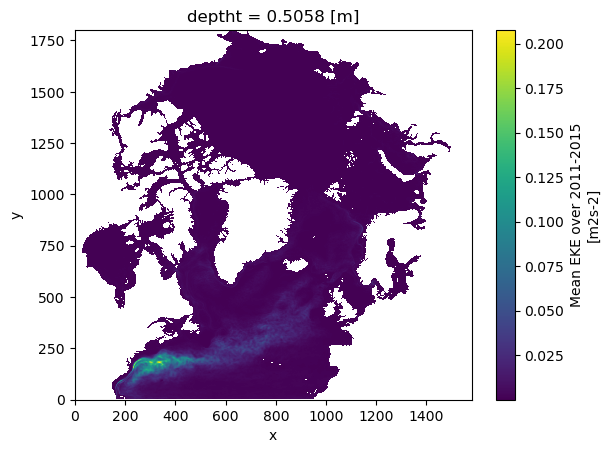

In [34]:
ds_yearout.voeke.isel(deptht=0).plot()

# Compute the log of EKE 

In [24]:
%%time 
if False: 
    DATAIN='/home/datawork-lops-drakkarcom/SIMULATION-OUTPUTS/FREDY/CONFIGS/CREG12.L75/CREG12.L75-REF08-MEAN/DIAGS/EKE/1y/'    
    ds_meanyear=xr.open_dataset(DATAIN+'CREG12.L75-REF08_2011-2015.1y_EKE.nc',chunks={'nav_lev':10,'y':1300, 'x':1300}, engine="netcdf4")
    print('           Size othe yearly EKE dataset :', ds_meanyear.nbytes*1e-9,'GB')
else:
    ds_meanyear=ds_yearout

           Size othe yearly EKE dataset : 2.58378694 GB
CPU times: user 20 ms, sys: 12 ms, total: 32 ms
Wall time: 135 ms


In [25]:
ds_meanyear

<xarray.Dataset>
Dimensions:  (y: 1801, x: 1580, deptht: 75)
Coordinates:
    nav_lat  (y, x) float32 dask.array<chunksize=(1300, 1300), meta=np.ndarray>
    nav_lon  (y, x) float32 dask.array<chunksize=(1300, 1300), meta=np.ndarray>
  * deptht   (deptht) float32 0.5058 1.556 2.668 ... 5.698e+03 5.902e+03
Dimensions without coordinates: y, x
Data variables:
    voeke    (deptht, y, x) float32 dask.array<chunksize=(75, 1300, 1300), meta=np.ndarray>
    votke    (deptht, y, x) float32 dask.array<chunksize=(75, 1300, 1300), meta=np.ndarray>
    vomke    (deptht, y, x) float32 dask.array<chunksize=(75, 1300, 1300), meta=np.ndarray>

# Compute the log of energetics terms

In [37]:
%%time 
# Compute the log of EKE 
print('           Compute the EKE Log field ')
ds_meanyear['logvotke']=(('nav_lev','y','x'),np.log10(np.array(ds_meanyear['votke'])))
ds_meanyear['logvomke']=(('nav_lev','y','x'),np.log10(np.array(ds_meanyear['vomke'])))
ds_meanyear['logvoeke']=(('nav_lev','y','x'),np.log10(np.array(ds_meanyear['voeke'])))

           Compute the EKE Log field 
CPU times: user 5.42 s, sys: 4.66 s, total: 10.1 s
Wall time: 16.1 s


In [40]:
%%time 
# Create a new Dataset for the mean energy  
if True: 
    ds_yearout=xr.Dataset()
    ds_yearout.coords['nav_lat']=(ds_sedna_bat['nav_lat'])
    ds_yearout.coords['nav_lon']=(ds_sedna_bat['nav_lon'])
    ds_yearout.coords['deptht']=(ds_year['deptht'])

    ds_yearout['logvoeke']=(('deptht','y','x'),xr.where(np.array(ds_mesh['tmask'][0,:,:,:]) == 0.,np.nan,np.array(ds_meanyear['logvoeke'])))
    ds_yearout['logvoeke'].attrs['long_name']='Mean Log10 EKE over 2011-2015'
    ds_yearout['logvoeke'].attrs['units']='m2s-2'

    ds_yearout['logvotke']=(('deptht','y','x'),xr.where(np.array(ds_mesh['tmask'][0,:,:,:]) == 0.,np.nan,np.array(ds_meanyear['logvotke'])))
    ds_yearout['logvotke'].attrs['long_name']='Mean Log10 KE over 2011-2015'
    ds_yearout['logvotke'].attrs['units']='m2s-2'

    ds_yearout['logvomke']=(('deptht','y','x'),xr.where(np.array(ds_mesh['tmask'][0,:,:,:]) == 0.,np.nan,np.array(ds_meanyear['logvomke'])))
    ds_yearout['logvomke'].attrs['long_name']='Mean Log10 MKE over 2011-2015'
    ds_yearout['logvomke'].attrs['units']='m2s-2' 
    DATAOUT='/home/datawork-lops-drakkarcom/SIMULATION-OUTPUTS/FREDY/CONFIGS/CREG12.L75/CREG12.L75-REF08-MEAN/DIAGS/EKE/1y/'    
    if True: ds_yearout.to_netcdf(DATAOUT+'CREG12.L75-REF08_2011-2015.1y_LogEKE.nc')

CPU times: user 2.24 s, sys: 3.97 s, total: 6.21 s
Wall time: 7.14 s


# Compute the vertical integral as the ratio EKE/KE MKE/KE as well 

In [26]:
ds_mesh

<xarray.Dataset>
Dimensions:   (t: 1, z: 75, y: 1801, x: 1580)
Coordinates:
    nav_lon   (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    nav_lat   (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
Dimensions without coordinates: t, z, y, x
Data variables: (12/22)
    e3t_0     (t, z, y, x) float64 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    e3u_0     (t, z, y, x) float64 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    e3v_0     (t, z, y, x) float64 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    gdept_1d  (t, z) float64 dask.array<chunksize=(1, 15), meta=np.ndarray>
    mbathy    (t, y, x) int16 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    tmask     (t, z, y, x) int8 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    ...        ...
    glamf     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    glamu     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    glamv     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    gphif     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    gphiu     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    gphiv     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
Attributes:
    history:  Thu Jul  4 10:33:09 2019: ncks -A -v glamt,glamu,glamv,glamf,gp...
    NCO:      4.4.6

In [27]:
# Add a vertical coordinate depth
#ds_mesh=ds_mesh.rename_dims({'z':'deptht'})
ds_mesh.coords['deptht']=(ds_meanyear['deptht'])
ds_mesh

<xarray.Dataset>
Dimensions:   (t: 1, z: 75, y: 1801, x: 1580, deptht: 75)
Coordinates:
    nav_lon   (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    nav_lat   (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
  * deptht    (deptht) float32 0.5058 1.556 2.668 ... 5.698e+03 5.902e+03
Dimensions without coordinates: t, z, y, x
Data variables: (12/22)
    e3t_0     (t, z, y, x) float64 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    e3u_0     (t, z, y, x) float64 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    e3v_0     (t, z, y, x) float64 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    gdept_1d  (t, z) float64 dask.array<chunksize=(1, 15), meta=np.ndarray>
    mbathy    (t, y, x) int16 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    tmask     (t, z, y, x) int8 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    ...        ...
    glamf     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    glamu     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    glamv     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    gphif     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    gphiu     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    gphiv     (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
Attributes:
    history:  Thu Jul  4 10:33:09 2019: ncks -A -v glamt,glamu,glamv,glamf,gp...
    NCO:      4.4.6

In [53]:
# Only keep the first 200m depth
ds_mesh=ds_mesh.where(ds_mesh['deptht'] <= 200., drop=True)
ds_mesh

<xarray.Dataset>
Dimensions:   (t: 1, deptht: 31, y: 1801, x: 1580)
Coordinates:
    nav_lon   (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    nav_lat   (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
  * deptht    (deptht) float32 0.5058 1.556 2.668 3.856 ... 163.2 180.5 199.8
Dimensions without coordinates: t, y, x
Data variables: (12/22)
    e3t_0     (t, deptht, y, x) float64 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    e3u_0     (t, deptht, y, x) float64 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    e3v_0     (t, deptht, y, x) float64 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    gdept_1d  (t, deptht) float64 dask.array<chunksize=(1, 15), meta=np.ndarray>
    mbathy    (t, y, x, deptht) float32 dask.array<chunksize=(1, 500, 500, 31), meta=np.ndarray>
    tmask     (t, deptht, y, x) float32 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    ...        ...
    glamf     (t, y, x, deptht) float32 dask.array<chunksize=(1, 500, 500, 31), meta=np.ndarray>
    glamu     (t, y, x, deptht) float32 dask.array<chunksize=(1, 500, 500, 31), meta=np.ndarray>
    glamv     (t, y, x, deptht) float32 dask.array<chunksize=(1, 500, 500, 31), meta=np.ndarray>
    gphif     (t, y, x, deptht) float32 dask.array<chunksize=(1, 500, 500, 31), meta=np.ndarray>
    gphiu     (t, y, x, deptht) float32 dask.array<chunksize=(1, 500, 500, 31), meta=np.ndarray>
    gphiv     (t, y, x, deptht) float32 dask.array<chunksize=(1, 500, 500, 31), meta=np.ndarray>
Attributes:
    history:  Thu Jul  4 10:33:09 2019: ncks -A -v glamt,glamu,glamv,glamf,gp...
    NCO:      4.4.6

In [28]:
ds_mesh['deptht']

<xarray.DataArray 'deptht' (deptht: 75)>
array([5.057600e-01, 1.555855e+00, 2.667682e+00, 3.856280e+00, 5.140361e+00,
       6.543034e+00, 8.092519e+00, 9.822750e+00, 1.177368e+01, 1.399104e+01,
       1.652532e+01, 1.942980e+01, 2.275762e+01, 2.655830e+01, 3.087456e+01,
       3.574020e+01, 4.118002e+01, 4.721189e+01, 5.385064e+01, 6.111284e+01,
       6.902168e+01, 7.761116e+01, 8.692943e+01, 9.704131e+01, 1.080303e+02,
       1.200000e+02, 1.330758e+02, 1.474062e+02, 1.631645e+02, 1.805499e+02,
       1.997900e+02, 2.211412e+02, 2.448906e+02, 2.713564e+02, 3.008875e+02,
       3.338628e+02, 3.706885e+02, 4.117939e+02, 4.576256e+02, 5.086399e+02,
       5.652923e+02, 6.280260e+02, 6.972587e+02, 7.733683e+02, 8.566790e+02,
       9.474479e+02, 1.045854e+03, 1.151991e+03, 1.265861e+03, 1.387377e+03,
       1.516364e+03, 1.652568e+03, 1.795671e+03, 1.945296e+03, 2.101027e+03,
       2.262422e+03, 2.429025e+03, 2.600380e+03, 2.776039e+03, 2.955570e+03,
       3.138565e+03, 3.324641e+03, 3.513446e+03, 3.704657e+03, 3.897982e+03,
       4.093159e+03, 4.289953e+03, 4.488155e+03, 4.687581e+03, 4.888070e+03,
       5.089479e+03, 5.291683e+03, 5.494575e+03, 5.698061e+03, 5.902058e+03],
      dtype=float32)
Coordinates:
  * deptht   (deptht) float32 0.5058 1.556 2.668 ... 5.698e+03 5.902e+03
Attributes:
    long_name:  Vertical T levels
    units:      m
    axis:       Z
    positive:   down
    bounds:     deptht_bounds

In [54]:
ds_meanyear=ds_meanyear.where(ds_meanyear['deptht'] <= 200., drop=True)
ds_meanyear

<xarray.Dataset>
Dimensions:  (deptht: 31, y: 1801, x: 1580)
Coordinates:
    nav_lat  (y, x) float32 dask.array<chunksize=(1300, 1300), meta=np.ndarray>
    nav_lon  (y, x) float32 dask.array<chunksize=(1300, 1300), meta=np.ndarray>
  * deptht   (deptht) float32 0.5058 1.556 2.668 3.856 ... 163.2 180.5 199.8
Dimensions without coordinates: y, x
Data variables:
    voeke    (deptht, y, x) float32 dask.array<chunksize=(31, 1300, 1300), meta=np.ndarray>
    votke    (deptht, y, x) float32 dask.array<chunksize=(31, 1300, 1300), meta=np.ndarray>
    vomke    (deptht, y, x) float32 dask.array<chunksize=(31, 1300, 1300), meta=np.ndarray>

In [55]:
%%time 
Zintvoeke=(ds_meanyear['voeke'][:,:,:]*ds_mesh['e3t_0'][0,:,:,:]).sum(dim='deptht').compute()

CPU times: user 884 ms, sys: 96 ms, total: 980 ms
Wall time: 3.43 s


In [56]:
%%time 
Zintvotke=(ds_meanyear['votke'][:,:,:]*ds_mesh['e3t_0'][0,:,:,:]).sum(dim='deptht').compute()

CPU times: user 1.1 s, sys: 84 ms, total: 1.19 s
Wall time: 3.54 s


In [57]:
%%time 
Zintvomke=(ds_meanyear['vomke'][:,:,:]*ds_mesh['e3t_0'][0,:,:,:]).sum(dim='deptht').compute()

CPU times: user 936 ms, sys: 72 ms, total: 1.01 s
Wall time: 2.91 s


In [58]:
%%time 
doDS=True
if doDS: 
    ds_EKEDiags=xr.Dataset()
    ds_EKEDiags.coords['nav_lat']=(ds_sedna_bat['nav_lat'])
    ds_EKEDiags.coords['nav_lon']=(ds_sedna_bat['nav_lon'])
    ds_EKEDiags['Zintvoeke']=(('y','x'),xr.where(np.array(ds_mesh['tmask'][0,0,:,:]) == 0.,np.nan,np.array(Zintvoeke)))
    ds_EKEDiags['Zintvoeke'].attrs['long_name']='Mean EKE (2011-2015) vertically integrated over 200m'
    ds_EKEDiags['Zintvoeke'].attrs['units']='m3s-2'

    ds_EKEDiags['Zintvotke']=(('y','x'),xr.where(np.array(ds_mesh['tmask'][0,0,:,:]) == 0.,np.nan,np.array(Zintvotke)))
    ds_EKEDiags['Zintvotke'].attrs['long_name']='Mean KE (2011-2015) vertically integrated over 200m'
    ds_EKEDiags['Zintvotke'].attrs['units']='m3s-2'

    ds_EKEDiags['Zintvomke']=(('y','x'),xr.where(np.array(ds_mesh['tmask'][0,0,:,:]) == 0.,np.nan,np.array(Zintvomke)))
    ds_EKEDiags['Zintvomke'].attrs['long_name']='Mean MKE (2011-2015) vertically integrated over 200m'
    ds_EKEDiags['Zintvomke'].attrs['units']='m3s-2'

    ds_EKEDiags['RmkeOke']=(('y','x'),xr.where(np.array(ds_mesh['tmask'][0,0,:,:]) == 0.,np.nan,np.array(Zintvomke/Zintvotke)))
    ds_EKEDiags['RmkeOke'].attrs['long_name']='Ratio MKE/KE (2011-2015) vertically integrated over 200m'
    ds_EKEDiags['RmkeOke'].attrs['units']='%'

    ds_EKEDiags['RekeOke']=(('y','x'),xr.where(np.array(ds_mesh['tmask'][0,0,:,:]) == 0.,np.nan,np.array(Zintvoeke/Zintvotke)))
    ds_EKEDiags['RekeOke'].attrs['long_name']='Ratio EKE/KE (2011-2015) vertically integrated over 200m'
    ds_EKEDiags['RekeOke'].attrs['units']='%'
    DATAOUT='/home/datawork-lops-drakkarcom/SIMULATION-OUTPUTS/FREDY/CONFIGS/CREG12.L75/CREG12.L75-REF08-MEAN/DIAGS/EKE/1y/'    
    if True: ds_EKEDiags.to_netcdf(DATAIN+'CREG12.L75-REF08_2011-2015.1y_ZintEKE.nc')

CPU times: user 468 ms, sys: 104 ms, total: 572 ms
Wall time: 1.45 s


# Output Log10 fields

In [47]:
%%time 
doDS=False
if doDS: 
    ds_EKEDiags=xr.Dataset()
    ds_EKEDiags.coords['nav_lat']=(ds_sedna_bat['nav_lat'])
    ds_EKEDiags.coords['nav_lon']=(ds_sedna_bat['nav_lon'])
    ds_EKEDiags['Zintvoeke']=(('y','x'),xr.where(np.array(ds_mesh['tmask'][0,0,:,:]) == 0.,np.nan,np.log10(np.array(Zintvoeke))))
    ds_EKEDiags['Zintvoeke'].attrs['long_name']='Mean Log10 EKE (2011-2015) vertically integrated over 200m'
    ds_EKEDiags['Zintvoeke'].attrs['units']='m3s-2'

    ds_EKEDiags['Zintvotke']=(('y','x'),xr.where(np.array(ds_mesh['tmask'][0,0,:,:]) == 0.,np.nan,np.log10(np.array(Zintvotke))))
    ds_EKEDiags['Zintvotke'].attrs['long_name']='Mean Log10 KE (2011-2015) vertically integrated over 200m'
    ds_EKEDiags['Zintvotke'].attrs['units']='m3s-2'

    ds_EKEDiags['Zintvomke']=(('y','x'),xr.where(np.array(ds_mesh['tmask'][0,0,:,:]) == 0.,np.nan,np.log10(np.array(Zintvomke))))
    ds_EKEDiags['Zintvomke'].attrs['long_name']='Mean Log10 MKE (2011-2015) vertically integrated over 200m'
    ds_EKEDiags['Zintvomke'].attrs['units']='m3s-2'

    ds_EKEDiags['RmkeOke']=(('y','x'),xr.where(np.array(ds_mesh['tmask'][0,0,:,:]) == 0.,np.nan,np.array(Zintvomke/Zintvotke)))
    ds_EKEDiags['RmkeOke'].attrs['long_name']='Ratio MKE/KE (2011-2015) vertically integrated over 200m'
    ds_EKEDiags['RmkeOke'].attrs['units']='%'

    ds_EKEDiags['RekeOke']=(('y','x'),xr.where(np.array(ds_mesh['tmask'][0,0,:,:]) == 0.,np.nan,np.array(Zintvoeke/Zintvotke)))
    ds_EKEDiags['RekeOke'].attrs['long_name']='Ratio EKE/KE (2011-2015) vertically integrated over 200m'
    ds_EKEDiags['RekeOke'].attrs['units']='%'
    DATAOUT='/home/datawork-lops-drakkarcom/SIMULATION-OUTPUTS/FREDY/CONFIGS/CREG12.L75/CREG12.L75-REF08-MEAN/DIAGS/EKE/1y/'    
    if True: ds_EKEDiags.to_netcdf(DATAIN+'CREG12.L75-REF08_2011-2015.1y_LogZintEKE.nc')

<timed exec>:6: RuntimeWarning: divide by zero encountered in log10
<timed exec>:10: RuntimeWarning: divide by zero encountered in log10
<timed exec>:14: RuntimeWarning: divide by zero encountered in log10


CPU times: user 844 ms, sys: 416 ms, total: 1.26 s
Wall time: 1.18 s


# Plot EKE maps @ surface, 81m & 147m & 411m

/dev/shm/pbs.8057394.datarmor0/ipykernel_54754/3431274990.py:38: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m.pcolormesh(X,Y,ztab,cmap=zmap,norm=znorm)
/dev/shm/pbs.8057394.datarmor0/ipykernel_54754/3431274990.py:38: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m.pcolormesh(X,Y,ztab,cmap=zmap,norm=znorm)
/dev/shm/pbs.8057394.datarmor0/ipykernel_54754/3431274990.py:38: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please suppl

CPU times: user 15.6 s, sys: 2.97 s, total: 18.5 s
Wall time: 28.5 s


<Figure size 640x480 with 0 Axes>

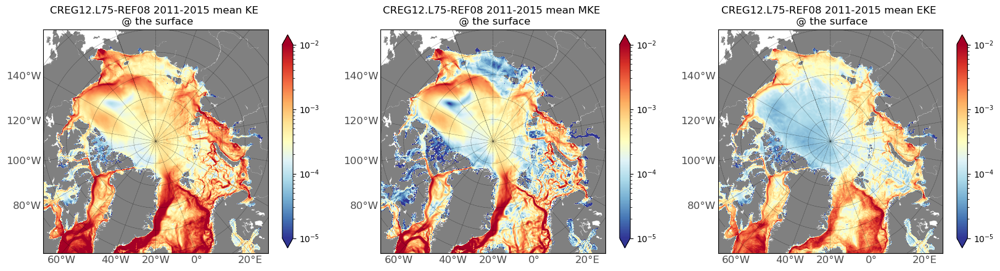

In [26]:
%%time
plt.clf()
vmin=10**-5 ; vmax=10**-2 ; vint=0.05
contours=np.arange(vmin,vmax+vint,vint)
limits=[vmin,vmax]

plt.figure(figsize=(20,15))
plt.subplot(131)
Arc_plot(np.array(ds_meanyear['nav_lon']),np.array(ds_meanyear['nav_lat']), \
         ds_meanyear.votke.sel(deptht=0,method='nearest'), \
         contours, limits, zmap='RdYlBu_r',proj='npstereNA',fld='KE',log10=True)
plt.title('CREG12.L75-REF08 2011-2015 mean KE \n @ the surface')

plt.subplot(132)
Arc_plot(np.array(ds_meanyear['nav_lon']),np.array(ds_meanyear['nav_lat']), \
         ds_meanyear.vomke.sel(deptht=0,method='nearest'), \
         contours, limits, zmap='RdYlBu_r',proj='npstereNA',fld='KE',log10=True)
plt.title('CREG12.L75-REF08 2011-2015 mean MKE \n @ the surface')

plt.subplot(133)
Arc_plot(np.array(ds_meanyear['nav_lon']),np.array(ds_meanyear['nav_lat']), \
         ds_meanyear.voeke.sel(deptht=0,method='nearest'), \
         contours, limits, zmap='RdYlBu_r',proj='npstereNA',fld='KE',log10=True)
plt.title('CREG12.L75-REF08 2011-2015 mean EKE \n @ the surface')

#GeoBox(fig)

if True : plt.savefig('./FIGURES/CREG12.L75-REF08_2011-2015.1y_TMEKE_z0m.png',dpi=300)

/dev/shm/pbs.8057394.datarmor0/ipykernel_54754/467297484.py:34: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m.pcolormesh(X,Y,ztab,cmap=zmap,norm=znorm)
/dev/shm/pbs.8057394.datarmor0/ipykernel_54754/467297484.py:34: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m.pcolormesh(X,Y,ztab,cmap=zmap,norm=znorm)
/dev/shm/pbs.8057394.datarmor0/ipykernel_54754/467297484.py:34: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply e

CPU times: user 15.5 s, sys: 1.72 s, total: 17.2 s
Wall time: 20 s


<Figure size 640x480 with 0 Axes>

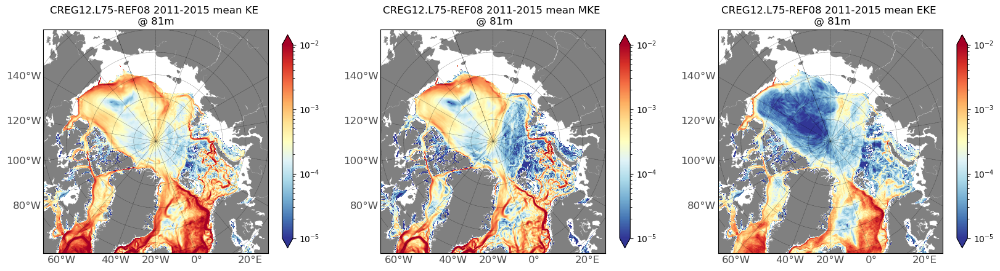

In [61]:
%%time
plt.clf()
vmin=10**-5 ; vmax=10**-2 ; vint=0.05
contours=np.arange(vmin,vmax+vint,vint)
limits=[vmin,vmax]

fig=plt.figure(figsize=(20,15))
plt.subplot(131)
Arc_plot(np.array(ds_meanyear['nav_lon']),np.array(ds_meanyear['nav_lat']), \
         ds_meanyear.votke.sel(deptht=81,method='nearest'), \
         contours, limits, zmap='RdYlBu_r',proj='npstereNA',fld='KE',log10=True)
plt.title('CREG12.L75-REF08 2011-2015 mean KE \n @ 81m ')

plt.subplot(132)
Arc_plot(np.array(ds_meanyear['nav_lon']),np.array(ds_meanyear['nav_lat']), \
         ds_meanyear.vomke.sel(deptht=81,method='nearest'), \
         contours, limits, zmap='RdYlBu_r',proj='npstereNA',fld='KE',log10=True)
plt.title('CREG12.L75-REF08 2011-2015 mean MKE \n @ 81m')

plt.subplot(133)
Arc_plot(np.array(ds_meanyear['nav_lon']),np.array(ds_meanyear['nav_lat']), \
         ds_meanyear.voeke.sel(deptht=81,method='nearest'), \
         contours, limits, zmap='RdYlBu_r',proj='npstereNA',fld='KE',log10=True)
plt.title('CREG12.L75-REF08 2011-2015 mean EKE \n @ 81m')

#GeoBox(fig)

if True : plt.savefig('./FIGURES/CREG12.L75-REF08_2011-2015.1y_TMEKE_z81m.png',dpi=300)

/dev/shm/pbs.8057394.datarmor0/ipykernel_54754/3431274990.py:38: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m.pcolormesh(X,Y,ztab,cmap=zmap,norm=znorm)
/dev/shm/pbs.8057394.datarmor0/ipykernel_54754/3431274990.py:38: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m.pcolormesh(X,Y,ztab,cmap=zmap,norm=znorm)
/dev/shm/pbs.8057394.datarmor0/ipykernel_54754/3431274990.py:38: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please suppl

CPU times: user 15 s, sys: 1.75 s, total: 16.8 s
Wall time: 17.4 s


<Figure size 640x480 with 0 Axes>

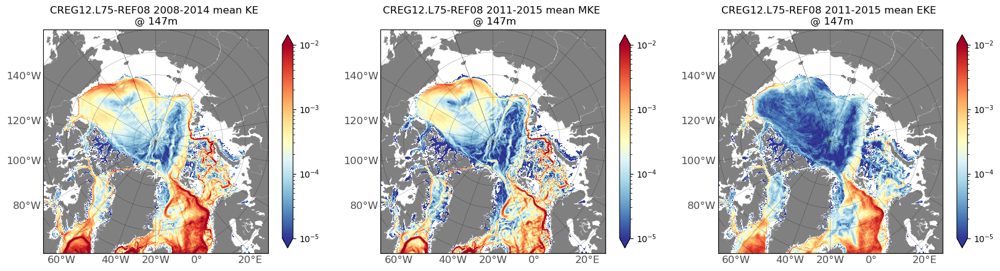

In [28]:
%%time
plt.clf()
vmin=10**-5 ; vmax=10**-2 ; vint=0.05
contours=np.arange(vmin,vmax+vint,vint)
limits=[vmin,vmax]

fig=plt.figure(figsize=(20,15))
plt.subplot(131)
Arc_plot(np.array(ds_meanyear['nav_lon']),np.array(ds_meanyear['nav_lat']), \
         ds_meanyear.votke.sel(deptht=147,method='nearest'), \
         contours, limits, zmap='RdYlBu_r',proj='npstereNA',fld='KE',log10=True)
plt.title('CREG12.L75-REF08 2008-2014 mean KE \n @ 147m ')

plt.subplot(132)
Arc_plot(np.array(ds_meanyear['nav_lon']),np.array(ds_meanyear['nav_lat']), \
         ds_meanyear.vomke.sel(deptht=147,method='nearest'), \
         contours, limits, zmap='RdYlBu_r',proj='npstereNA',fld='KE',log10=True)
plt.title('CREG12.L75-REF08 2011-2015 mean MKE \n @ 147m')

plt.subplot(133)
Arc_plot(np.array(ds_meanyear['nav_lon']),np.array(ds_meanyear['nav_lat']), \
         ds_meanyear.voeke.sel(deptht=147,method='nearest'), \
         contours, limits, zmap='RdYlBu_r',proj='npstereNA',fld='KE',log10=True)
plt.title('CREG12.L75-REF08 2011-2015 mean EKE \n @ 147m')

#GeoBox(fig)

if True : plt.savefig('./FIGURES/CREG12.L75-REF08_2011-2015.1y_TMEKE_z147m.png',dpi=300)

/dev/shm/pbs.8107389.datarmor0/ipykernel_8195/467297484.py:34: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m.pcolormesh(X,Y,ztab,cmap=zmap,norm=znorm)
/dev/shm/pbs.8107389.datarmor0/ipykernel_8195/467297484.py:34: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m.pcolormesh(X,Y,ztab,cmap=zmap,norm=znorm)
/dev/shm/pbs.8107389.datarmor0/ipykernel_8195/467297484.py:34: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply expl

CPU times: user 15.2 s, sys: 3.04 s, total: 18.3 s
Wall time: 30.7 s


<Figure size 640x480 with 0 Axes>

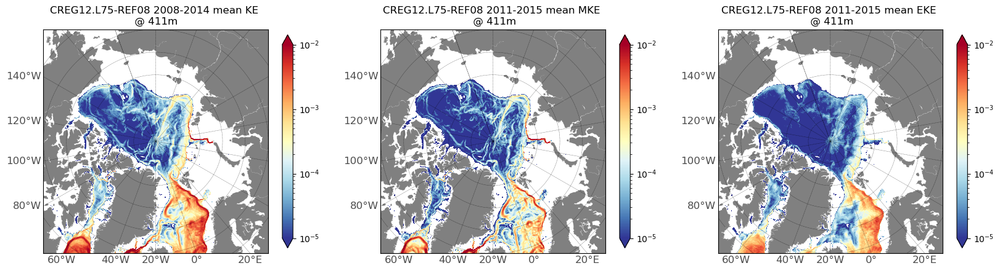

In [29]:
%%time
plt.clf()
vmin=10**-5 ; vmax=10**-2 ; vint=0.05
contours=np.arange(vmin,vmax+vint,vint)
limits=[vmin,vmax]

fig=plt.figure(figsize=(20,15))
plt.subplot(131)
Arc_plot(np.array(ds_meanyear['nav_lon']),np.array(ds_meanyear['nav_lat']), \
         ds_meanyear.votke.sel(deptht=400,method='nearest'), \
         contours, limits, zmap='RdYlBu_r',proj='npstereNA',fld='KE',log10=True)
plt.title('CREG12.L75-REF08 2008-2014 mean KE \n @ 411m ')

plt.subplot(132)
Arc_plot(np.array(ds_meanyear['nav_lon']),np.array(ds_meanyear['nav_lat']), \
         ds_meanyear.vomke.sel(deptht=400,method='nearest'), \
         contours, limits, zmap='RdYlBu_r',proj='npstereNA',fld='KE',log10=True)
plt.title('CREG12.L75-REF08 2011-2015 mean MKE \n @ 411m')

plt.subplot(133)
Arc_plot(np.array(ds_meanyear['nav_lon']),np.array(ds_meanyear['nav_lat']), \
         ds_meanyear.voeke.sel(deptht=400,method='nearest'), \
         contours, limits, zmap='RdYlBu_r',proj='npstereNA',fld='KE',log10=True)
plt.title('CREG12.L75-REF08 2011-2015 mean EKE \n @ 411m')

#GeoBox(fig)

if True : plt.savefig('./FIGURES/CREG12.L75-REF08_2011-2015.1y_TMEKE_z411m.png',dpi=300)

# Plot the ratio EKE/KE & MKE/EKE @ surface, 81m & 147m & 411m 

/dev/shm/pbs.8057394.datarmor0/ipykernel_54754/4274664804.py:38: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m.pcolormesh(X,Y,ztab,cmap=zmap,norm=znorm)
/dev/shm/pbs.8057394.datarmor0/ipykernel_54754/4274664804.py:38: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m.pcolormesh(X,Y,ztab,cmap=zmap,norm=znorm)


CPU times: user 11 s, sys: 1.47 s, total: 12.5 s
Wall time: 18.5 s


<Figure size 640x480 with 0 Axes>

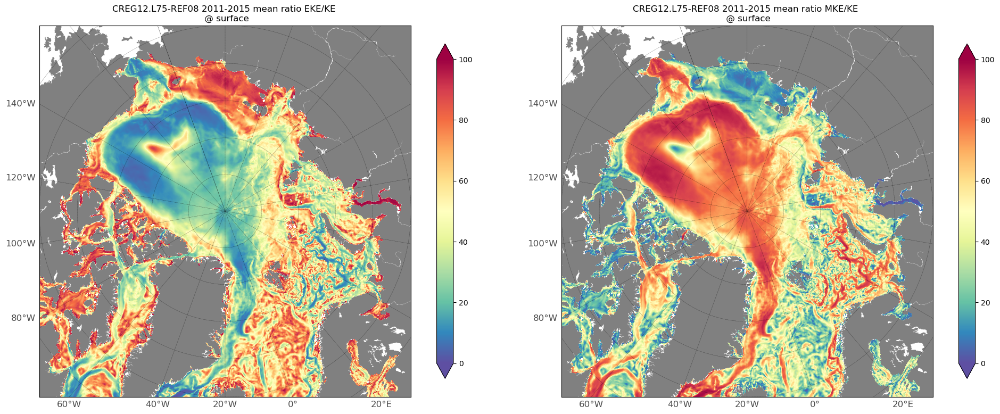

In [41]:
%%time
plt.clf()
vmin=0. ; vmax=100. ; vint=10.
contours=np.arange(vmin,vmax+vint,vint)
limits=[vmin,vmax]

fig=plt.figure(figsize=(20,15))
plt.subplot(221)
Arc_plot(np.array(ds_meanyear['nav_lon']),np.array(ds_meanyear['nav_lat']), \
         ((ds_meanyear['voeke']/ds_meanyear['votke'])*100.).isel(deptht=0), \
         contours, limits, zmap='Spectral_r',proj='npstereNA',fld='KE')
plt.title('CREG12.L75-REF08 2011-2015 mean ratio EKE/KE \n @ surface')

plt.subplot(222)
Arc_plot(np.array(ds_meanyear['nav_lon']),np.array(ds_meanyear['nav_lat']), \
         ((ds_meanyear['vomke']/ds_meanyear['votke'])*100.).isel(deptht=0), \
         contours, limits, zmap='Spectral_r',proj='npstereNA',fld='KE')
plt.title('CREG12.L75-REF08 2011-2015 mean ratio MKE/KE \n @ surface')

plt.tight_layout()
#GeoBox(fig)

if True : plt.savefig('./FIGURES/REF08-EKE_Ratio_z0m_y20112015.png',dpi=300)

/dev/shm/pbs.8057394.datarmor0/ipykernel_54754/4274664804.py:38: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m.pcolormesh(X,Y,ztab,cmap=zmap,norm=znorm)
/dev/shm/pbs.8057394.datarmor0/ipykernel_54754/4274664804.py:38: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m.pcolormesh(X,Y,ztab,cmap=zmap,norm=znorm)


CPU times: user 10.8 s, sys: 1.5 s, total: 12.3 s
Wall time: 16.3 s


<Figure size 640x480 with 0 Axes>

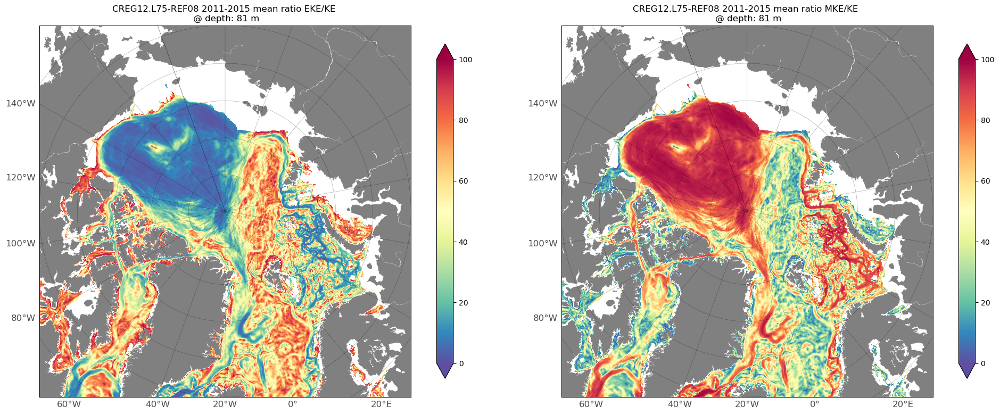

In [42]:
%%time
plt.clf()
vmin=0. ; vmax=100. ; vint=10.
contours=np.arange(vmin,vmax+vint,vint)
limits=[vmin,vmax]

fig=plt.figure(figsize=(20,15))
plt.subplot(221)
Arc_plot(np.array(ds_meanyear['nav_lon']),np.array(ds_meanyear['nav_lat']), \
         ((ds_meanyear['voeke']/ds_meanyear['votke'])*100.).isel(deptht=21), \
         contours, limits, zmap='Spectral_r',proj='npstereNA',fld='KE')
plt.title('CREG12.L75-REF08 2011-2015 mean ratio EKE/KE \n @ depth: 81 m')

plt.subplot(222)
Arc_plot(np.array(ds_meanyear['nav_lon']),np.array(ds_meanyear['nav_lat']), \
         ((ds_meanyear['vomke']/ds_meanyear['votke'])*100.).isel(deptht=21), \
         contours, limits, zmap='Spectral_r',proj='npstereNA',fld='KE')
plt.title('CREG12.L75-REF08 2011-2015 mean ratio MKE/KE \n @ depth: 81 m')

plt.tight_layout()
#GeoBox(fig)

if True : plt.savefig('./FIGURES/REF08-EKE_Ratio_z81m_y20112015.png',dpi=300)

/dev/shm/pbs.8057394.datarmor0/ipykernel_54754/4274664804.py:38: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m.pcolormesh(X,Y,ztab,cmap=zmap,norm=znorm)
/dev/shm/pbs.8057394.datarmor0/ipykernel_54754/4274664804.py:38: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m.pcolormesh(X,Y,ztab,cmap=zmap,norm=znorm)


CPU times: user 11 s, sys: 1.43 s, total: 12.4 s
Wall time: 16 s


<Figure size 640x480 with 0 Axes>

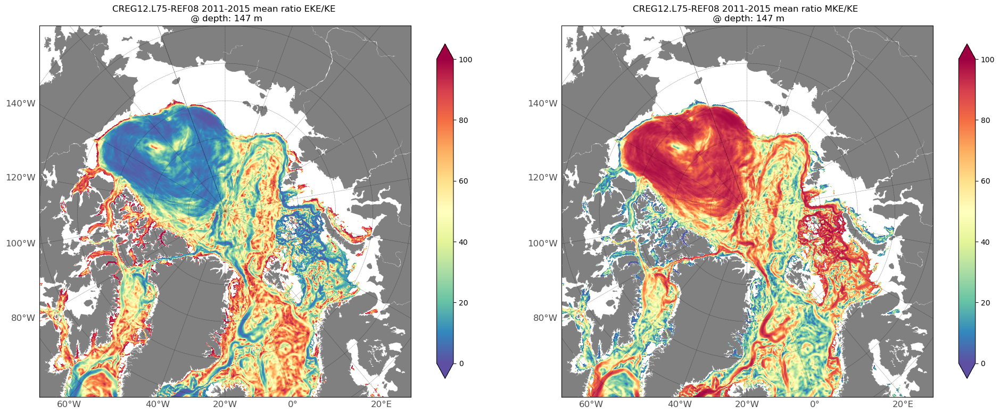

In [43]:
%%time
plt.clf()
vmin=0. ; vmax=100. ; vint=10.
contours=np.arange(vmin,vmax+vint,vint)
limits=[vmin,vmax]

fig=plt.figure(figsize=(20,15))
plt.subplot(221)
Arc_plot(np.array(ds_meanyear['nav_lon']),np.array(ds_meanyear['nav_lat']), \
         ((ds_meanyear['voeke']/ds_meanyear['votke'])*100.).isel(deptht=27), \
         contours, limits, zmap='Spectral_r',proj='npstereNA',fld='KE')
plt.title('CREG12.L75-REF08 2011-2015 mean ratio EKE/KE \n @ depth: 147 m')

plt.subplot(222)
Arc_plot(np.array(ds_meanyear['nav_lon']),np.array(ds_meanyear['nav_lat']), \
         ((ds_meanyear['vomke']/ds_meanyear['votke'])*100.).isel(deptht=27), \
         contours, limits, zmap='Spectral_r',proj='npstereNA',fld='KE')
plt.title('CREG12.L75-REF08 2011-2015 mean ratio MKE/KE \n @ depth: 147 m')

plt.tight_layout()
#GeoBox(fig)

if True : plt.savefig('./FIGURES/REF08-EKE_Ratio_z147m_y20112015.png',dpi=300)

/dev/shm/pbs.8107389.datarmor0/ipykernel_8195/2976925446.py:34: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m.pcolormesh(X,Y,ztab,cmap=zmap,norm=znorm)
/dev/shm/pbs.8107389.datarmor0/ipykernel_8195/2976925446.py:34: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m.pcolormesh(X,Y,ztab,cmap=zmap,norm=znorm)


CPU times: user 10.8 s, sys: 1.43 s, total: 12.2 s
Wall time: 20.7 s


<Figure size 640x480 with 0 Axes>

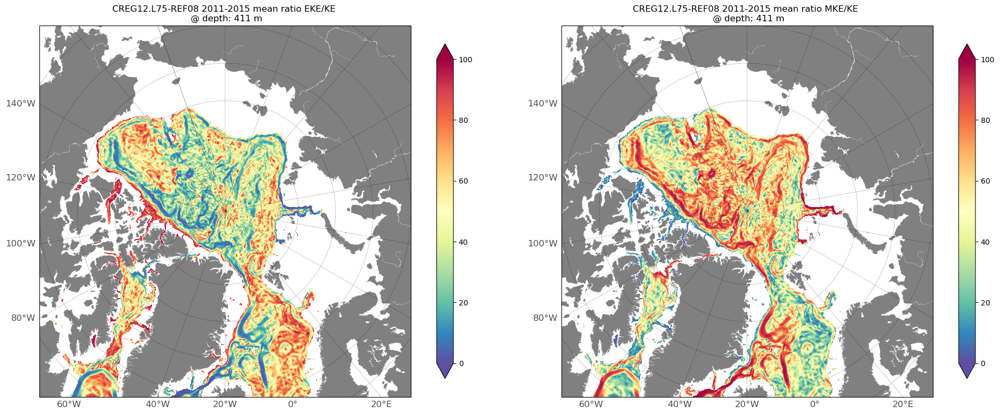

In [42]:
%%time
plt.clf()
vmin=0. ; vmax=100. ; vint=10.
contours=np.arange(vmin,vmax+vint,vint)
limits=[vmin,vmax]

fig=plt.figure(figsize=(20,15))
plt.subplot(221)
Arc_plot(np.array(ds_meanyear['nav_lon']),np.array(ds_meanyear['nav_lat']), \
         ((ds_meanyear['voeke']/ds_meanyear['votke'])*100.).isel(deptht=37), \
         contours, limits, zmap='Spectral_r',proj='npstereNA',fld='KE')
plt.title('CREG12.L75-REF08 2011-2015 mean ratio EKE/KE \n @ depth: 411 m')

plt.subplot(222)
Arc_plot(np.array(ds_meanyear['nav_lon']),np.array(ds_meanyear['nav_lat']), \
         ((ds_meanyear['vomke']/ds_meanyear['votke'])*100.).isel(deptht=37), \
         contours, limits, zmap='Spectral_r',proj='npstereNA',fld='KE')
plt.title('CREG12.L75-REF08 2011-2015 mean ratio MKE/KE \n @ depth: 411 m')

plt.tight_layout()
#GeoBox(fig)

if True : plt.savefig('./FIGURES/REF08-EKE_Ratio_z411m_y20112015.png',dpi=300)

In [39]:
print(int(ds_meanyear['deptht'].sel(deptht=400, method='nearest').values))
print(int(ds_meanyear['deptht'].isel(deptht=37).values))

411
411


# Plot the vertical integration over 200m for KE, EKE & MKE   

CPU times: user 300 ms, sys: 44 ms, total: 344 ms
Wall time: 342 ms


Text(0.5, 1.0, 'CREG12.L75-REF08 2011-2015 mean KE \n vertically integrated over 200m')

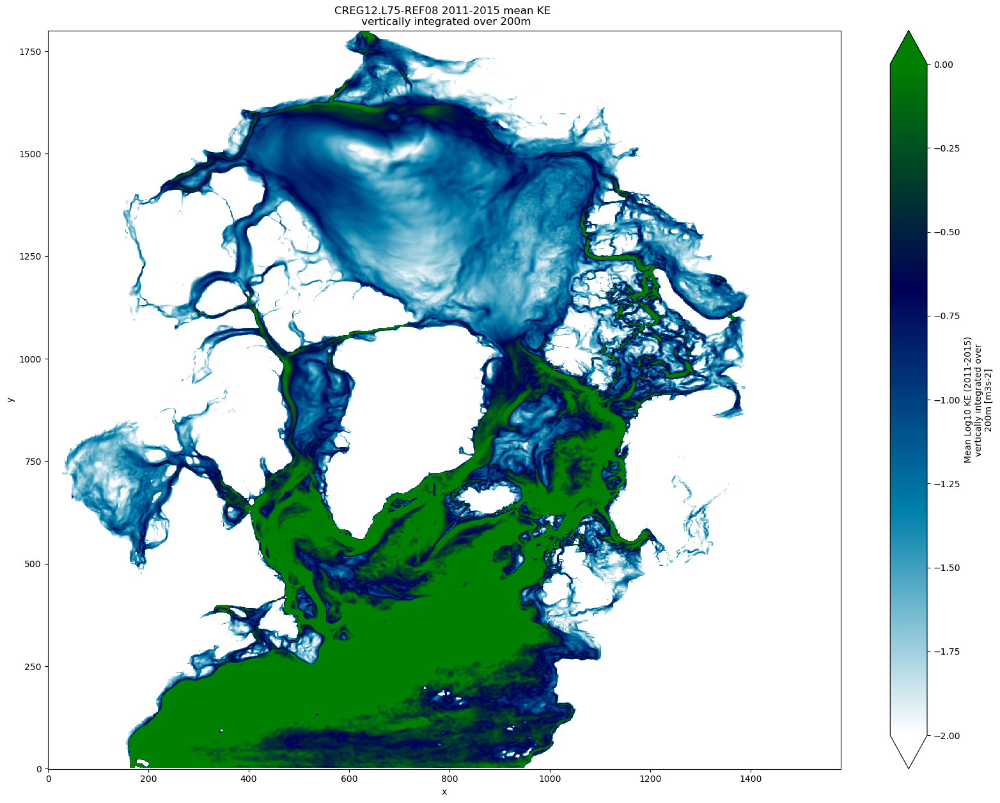

In [48]:
%%time 
plt.figure(figsize=(20,15))
ds_EKEDiags.Zintvotke.plot(cmap='ocean_r',vmin=-2., vmax=0.)
plt.title('CREG12.L75-REF08 2011-2015 mean KE \n vertically integrated over 200m')

CPU times: user 304 ms, sys: 24 ms, total: 328 ms
Wall time: 326 ms


Text(0.5, 1.0, 'CREG12.L75-REF08 2011-2015 yearly mean MKE \n vertically integrated over 200m')

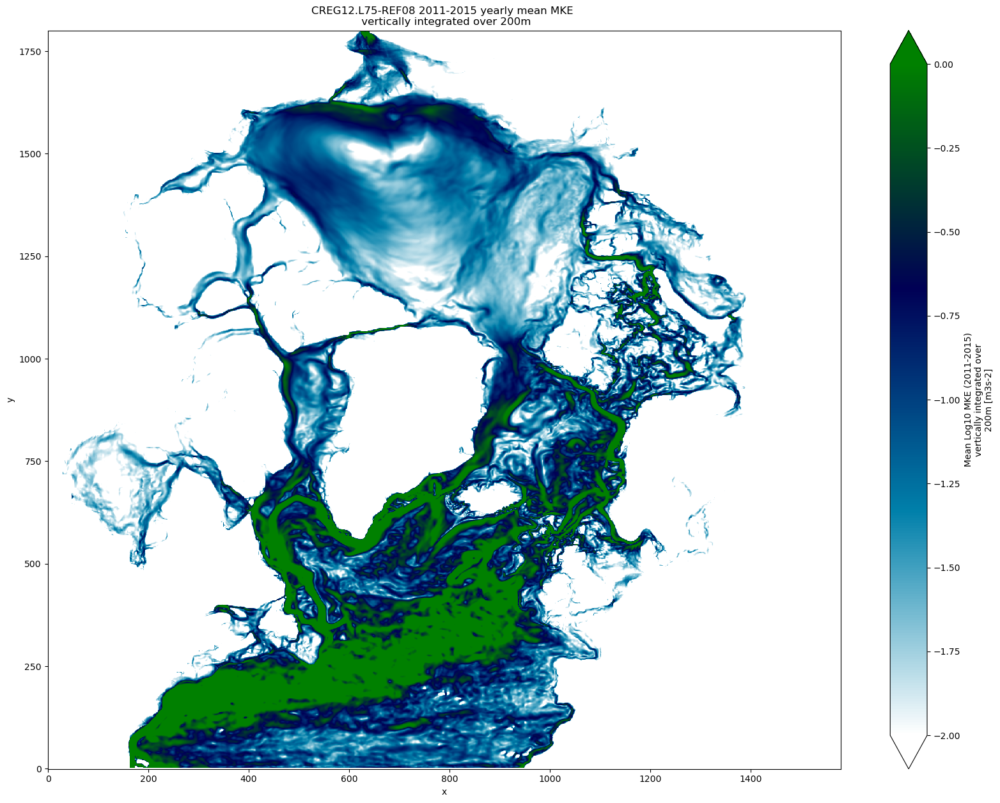

In [49]:
%%time 
plt.figure(figsize=(20,15))
ds_EKEDiags.Zintvomke.plot(cmap='ocean_r',vmin=-2., vmax=0.)
plt.title('CREG12.L75-REF08 2011-2015 yearly mean MKE \n vertically integrated over 200m')

CPU times: user 304 ms, sys: 12 ms, total: 316 ms
Wall time: 317 ms


Text(0.5, 1.0, 'CREG12.L75-REF08 2011-2015 mean EKE \n vertically integrated over 200m')

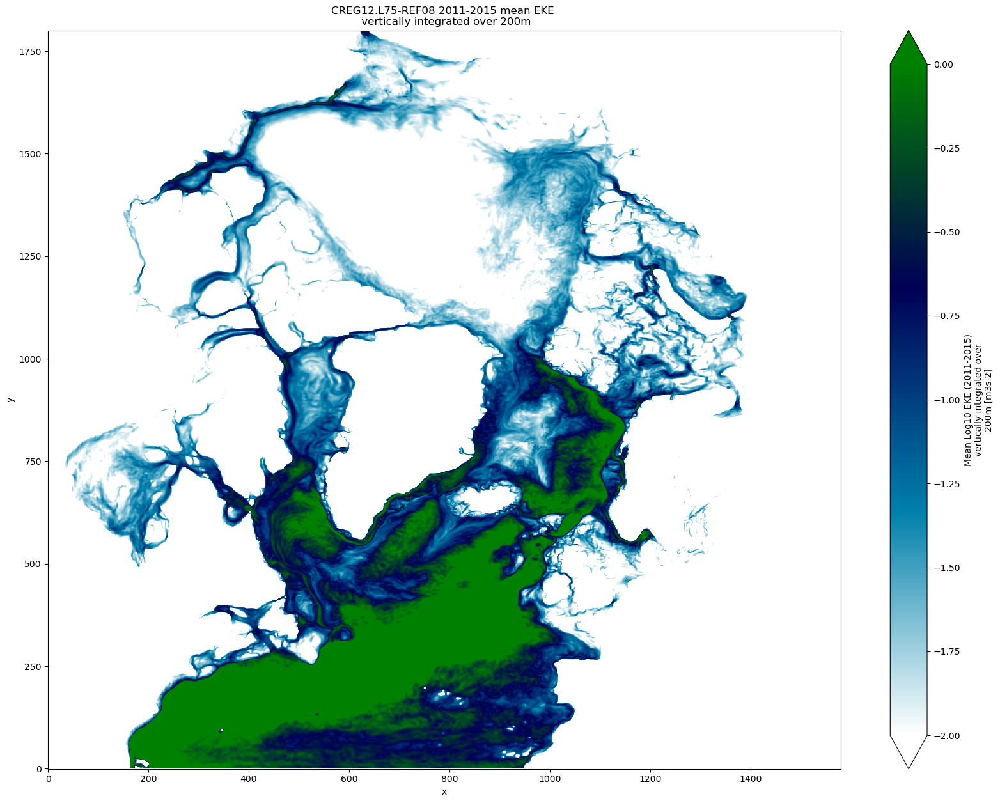

In [50]:
%%time 
plt.figure(figsize=(20,15))
ds_EKEDiags.Zintvoeke.plot(cmap='ocean_r',vmin=-2., vmax=0.)
plt.title('CREG12.L75-REF08 2011-2015 mean EKE \n vertically integrated over 200m')

# Plot the ratio EKE/TKE

In [20]:
%%time
if False:
    DATAIN='/home/datawork-lops-drakkarcom/SIMULATION-OUTPUTS/IMMEDIAT/CONFIGS/SEDNA/DELTA/DIAGS/EKE/1y/'
    ds_EKEDiags=xr.open_dataset(DATAIN+'SEDNA-DELTA_2011-2015.1y_LogZintEKE.nc')

CPU times: user 24 ms, sys: 12 ms, total: 36 ms
Wall time: 179 ms


CPU times: user 312 ms, sys: 32 ms, total: 344 ms
Wall time: 341 ms


Text(0.5, 1.0, 'CREG12.L75-REF08 2011-2015 mean ratio EKE/KE \n vertically integrated over 200m')

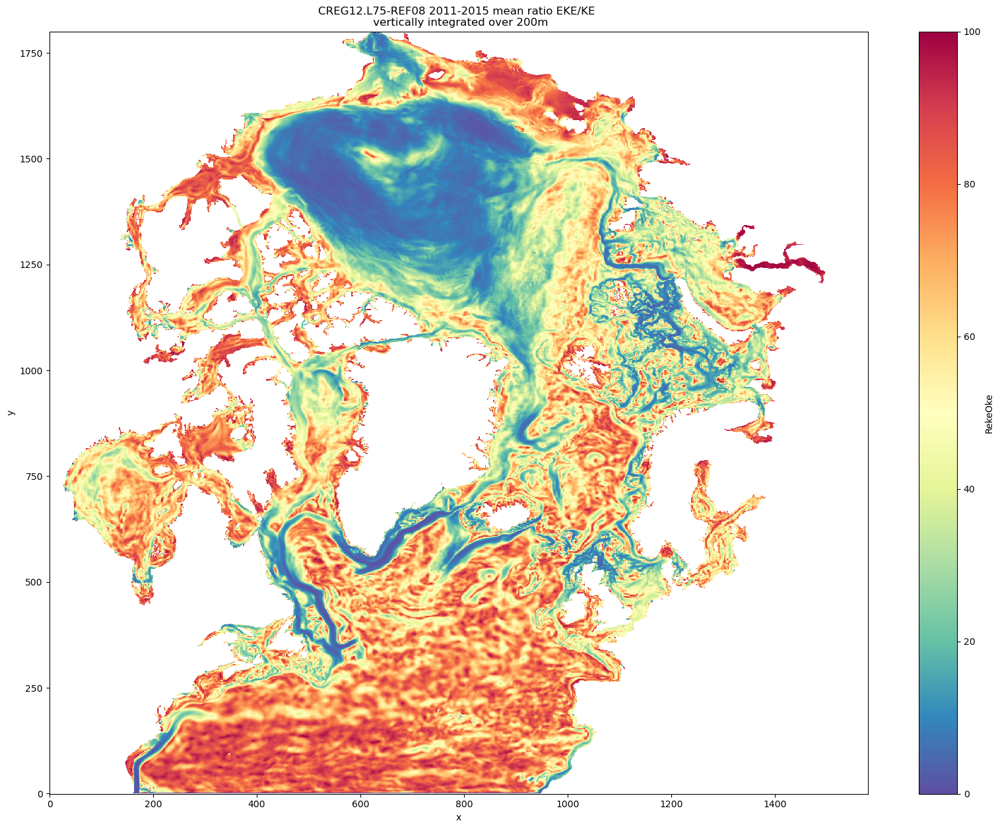

In [51]:
%%time 
plt.figure(figsize=(20,15))
(ds_EKEDiags.RekeOke*100.).plot(cmap='Spectral_r',vmin=0., vmax=100.)
plt.title('CREG12.L75-REF08 2011-2015 mean ratio EKE/KE \n vertically integrated over 200m')

CPU times: user 296 ms, sys: 36 ms, total: 332 ms
Wall time: 328 ms


Text(0.5, 1.0, 'CREG12.L75-REF08 2011-2015 mean ratio MKE/KE \n vertically integrated over 200m')

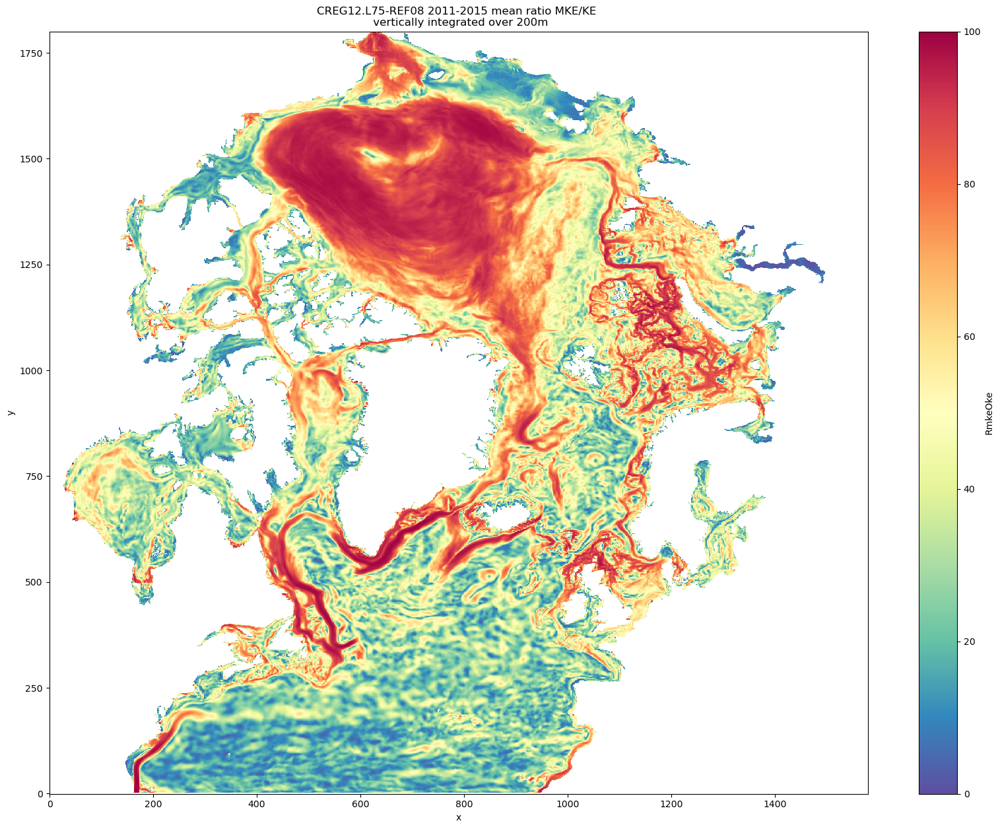

In [52]:
%%time 
plt.figure(figsize=(20,15))
(ds_EKEDiags.RmkeOke*100.).plot(cmap='Spectral_r',vmin=0., vmax=100.)
plt.title('CREG12.L75-REF08 2011-2015 mean ratio MKE/KE \n vertically integrated over 200m')

In [62]:
client.close()
cluster.close()

/home1/datawork/ctalandi/conda-env/Jupyter-Dask/lib/python3.11/site-packages/dask_jobqueue/core.py:255: FutureWarning: job_extra has been renamed to job_extra_directives. You are still using it (even if only set to []; please also check config files). If you did not set job_extra_directives yet, job_extra will be respected for now, but it will be removed in a future release. If you already set job_extra_directives, job_extra is ignored and you can remove it.
  warnings.warn(warn, FutureWarning)


# PLOT TESTING - PLOT TESTING 

In [24]:
ds_yearout=xr.open_dataset(DATAIN+'SEDNA-DELTA_2011-2015.1y_LogEKE.nc')

In [27]:
ds_yearout.coords['nav_lev']=(ds_mesh['nav_lev'])

In [28]:
ds_yearout

<xarray.Dataset>
Dimensions:   (y: 6540, x: 6560, nav_lev: 57)
Coordinates:
    nav_lon   (y, x) float64 ...
    nav_lat   (y, x) float64 ...
  * nav_lev   (nav_lev) float32 0.4915 1.526 2.63 3.804 ... 181.8 188.0 194.3
Dimensions without coordinates: y, x
Data variables:
    logvoeke  (nav_lev, y, x) float32 ...
    logvotke  (nav_lev, y, x) float32 ...
    logvomke  (nav_lev, y, x) float32 ...

CPU times: user 25.5 s, sys: 2.42 s, total: 27.9 s
Wall time: 27.6 s


<Figure size 640x480 with 0 Axes>

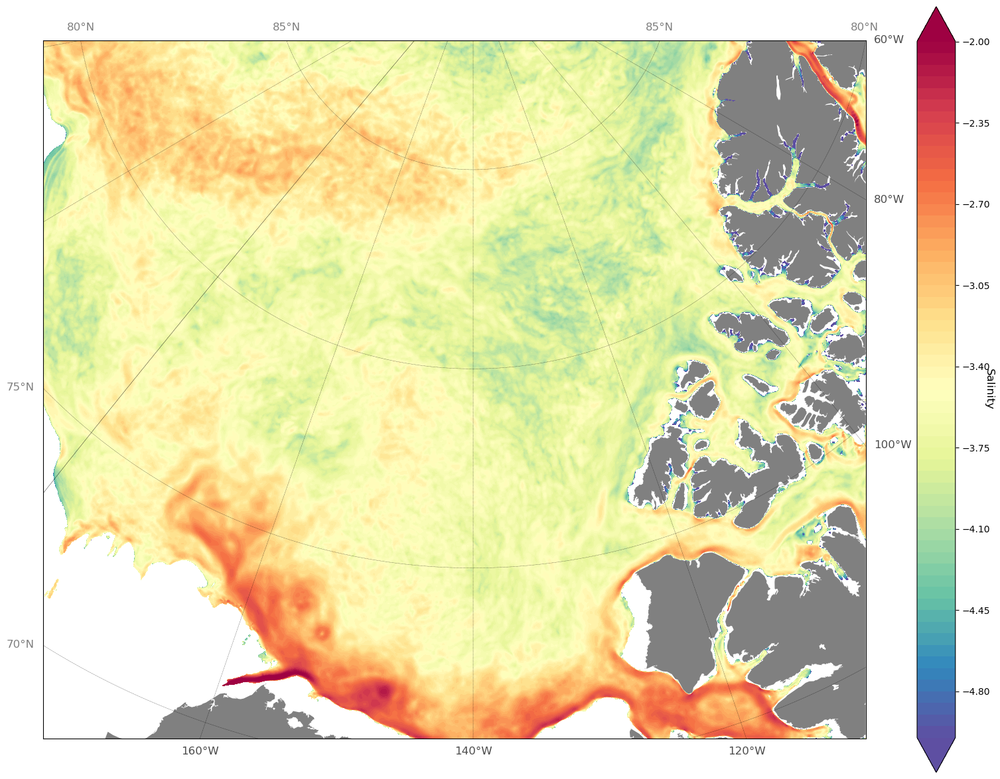

In [30]:
%%time
plt.clf()
vmin=-5. ; vmax=-2. ; vint=0.05
contours=np.arange(vmin,vmax+vint,vint)
limits=[vmin,vmax]

fig=plt.figure(figsize=(20,15))
plt.subplot(111)
Arc_plot(np.array(ds_yearout['nav_lon']),np.array(ds_yearout['nav_lat']), \
         #ds_alpha_S['vosaline'][0,54,:,:], contours, limits, zmap='Spectral_r',proj='cassi')
         #xr.where(ds_alpha_S['vosaline'][0,54,:,:] <= 1,np.nan,ds_alpha_S['vosaline'][0,54,:,:]), \
         ds_yearout.logvoeke.sel(nav_lev=81,method='nearest'), \
         contours, limits, zmap='Spectral_r',proj='cassi',fld='Salinity')

#GeoBox(fig)

if False : plt.savefig('./FIGURES/SEDNA-ALPHA_y2003m06d23_S_z181m_'+ext+'.png',dpi=250)

>>> # Plot a zoom of the Beaufort Gyre

<Figure size 432x288 with 0 Axes>

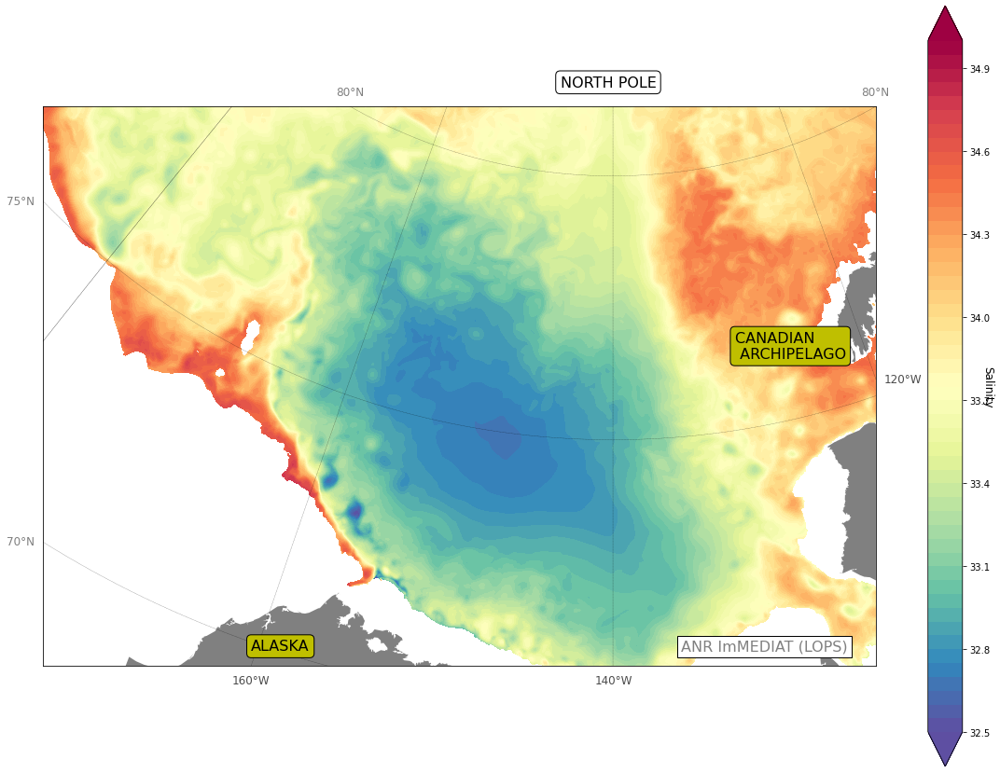

In [40]:
plt.clf()
vmin=32.5 ; vmax=35. ; vint=0.05
contours=np.arange(vmin,vmax+vint,vint)
limits=[vmin,vmax]

fig=plt.figure(figsize=(20,15))
plt.subplot(111)
Arc_plot(np.array(ds_alpha_S['nav_lon']),np.array(ds_alpha_S['nav_lat']), \
         #ds_alpha_S['vosaline'][0,54,:,:], contours, limits, zmap='Spectral_r',proj='cassi')
         xr.where(ds_alpha_S['vosaline'][0,54,:,:] <= 1,np.nan,ds_alpha_S['vosaline'][0,54,:,:]), \
         contours, limits, zmap='Spectral_r',proj='cassis_BGZoom',fld='Salinity')

GeoBox(fig,area='zoom')

if mplot : plt.savefig('./FIGURES/SEDNA-ALPHA_y2003m06d23_S_z181m_'+ext+'Zoom.png',dpi=250)

In [41]:
ds_alpha_T=xr.open_dataset(DATAIN+'SEDNA-ALPHA_y2003m06d23.1d_gridT_Z_SDOM-ARC.nc')

<Figure size 432x288 with 0 Axes>

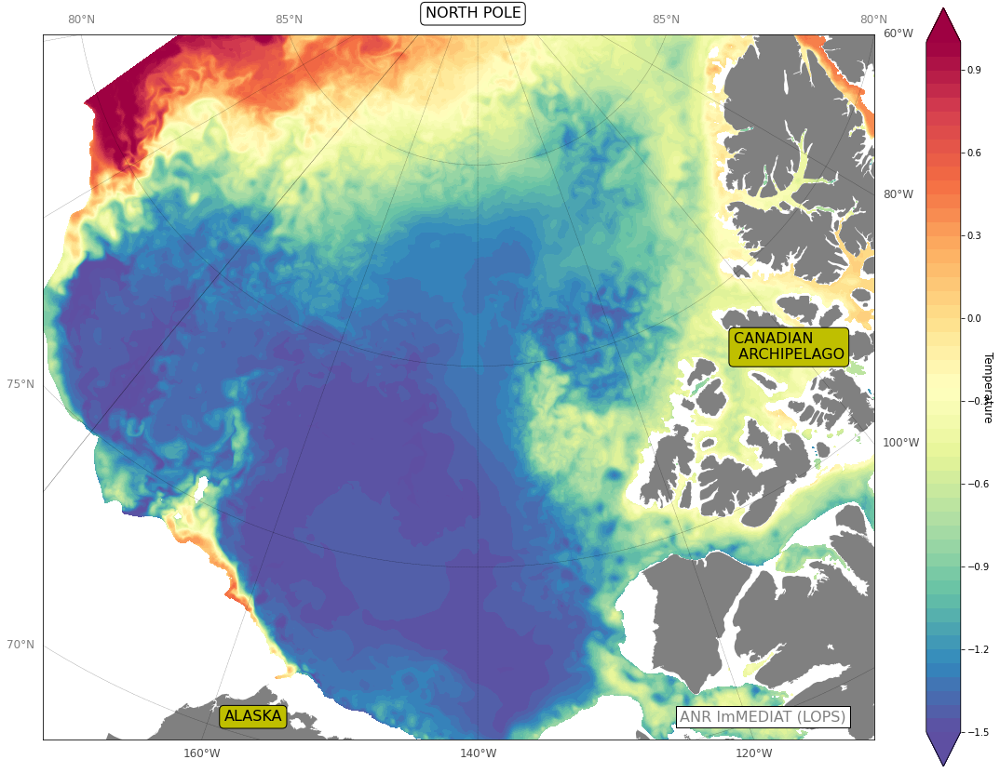

In [42]:
plt.clf()
vmin=-1.5 ; vmax=1. ; vint=0.05
contours=np.arange(vmin,vmax+vint,vint)
limits=[vmin,vmax]

fig=plt.figure(figsize=(20,15))
plt.subplot(111)
Arc_plot(np.array(ds_alpha_T['nav_lon']),np.array(ds_alpha_T['nav_lat']), \
         xr.where(ds_alpha_S['vosaline'][0,54,:,:] <= 1.,np.nan,ds_alpha_T['votemper'][0,54,:,:]), \
         contours, limits, zmap='Spectral_r',proj='cassi',fld='Temperature')

GeoBox(fig)

if mplot : plt.savefig('./FIGURES/SEDNA-ALPHA_y2003m06d23_T_z181m_'+ext+'.png',dpi=250)

In [43]:
ds_alpha_xiz181=xr.open_dataset(DATAIN+'SEDNA-ALPHA_y2004m06d23.1d_Xif_Z_lev54.nc')

<Figure size 432x288 with 0 Axes>

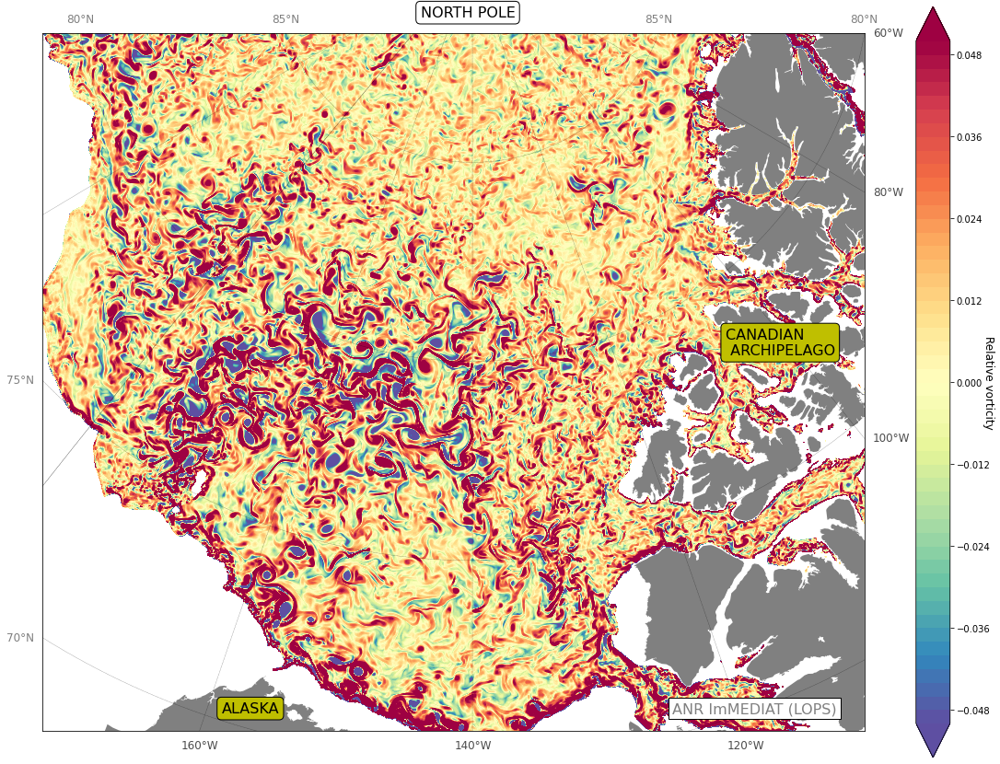

In [44]:
plt.clf()
vmin=-0.05 ; vmax=0.05 ; vint=0.002
contours=np.arange(vmin,vmax+vint,vint)
limits=[vmin,vmax]

fig=plt.figure(figsize=(20,15))
plt.subplot(111)
Arc_plot(np.array(ds_alpha_xiz181['nav_lon']),np.array(ds_alpha_xiz181['nav_lat']), \
         ds_alpha_xiz181['socurloverf'][0,:,:], contours, limits, zmap='Spectral_r', \
         fld='Relative vorticity')

GeoBox(fig)

if mplot : plt.savefig('./FIGURES/SEDNA-ALPHA_y2003m06d23_Xif_z181m_'+ext+'.png',dpi=250)
if False : plt.savefig('./FIGURES/SEDNA-ALPHA_y2003m06d23_Xif_z181m_'+ext+'HR.pdf')

<Figure size 432x288 with 0 Axes>

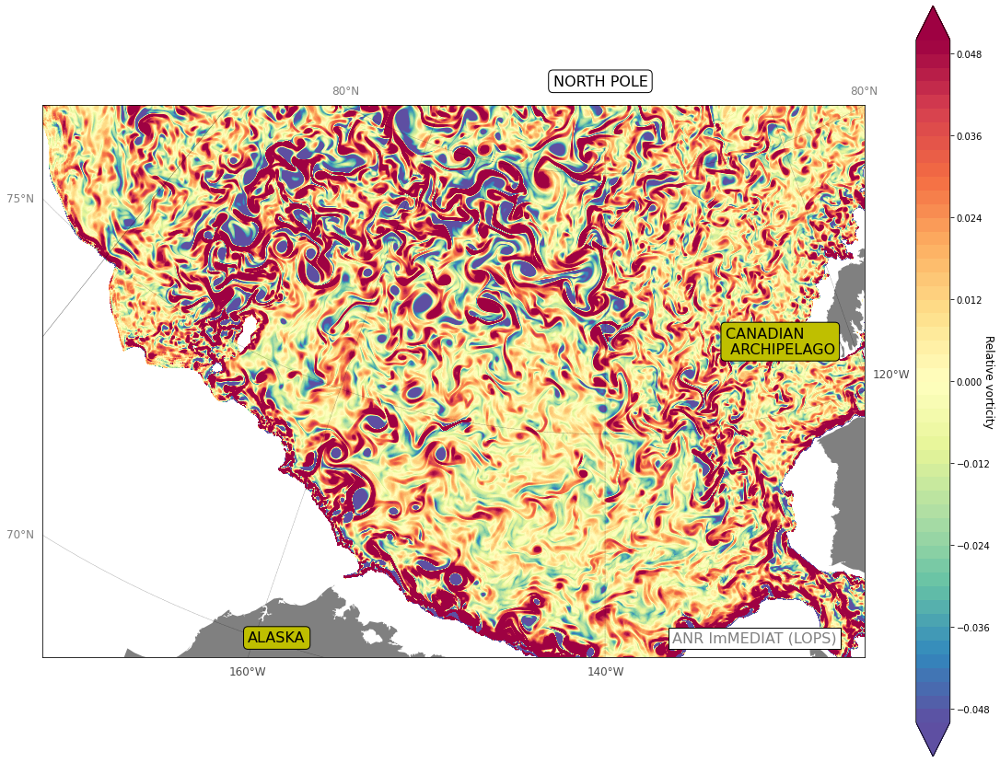

In [21]:
plt.clf()
vmin=-0.05 ; vmax=0.05 ; vint=0.002
contours=np.arange(vmin,vmax+vint,vint)
limits=[vmin,vmax]

fig=plt.figure(figsize=(20,15))
plt.subplot(111)
Arc_plot(np.array(ds_alpha_xiz181['nav_lon']),np.array(ds_alpha_xiz181['nav_lat']), \
         ds_alpha_xiz181['socurloverf'][0,:,:], contours, limits, zmap='Spectral_r',\
         proj='cassis_BGZoom',fld='Relative vorticity')

GeoBox(fig,area='zoom')

if False : plt.savefig('./FIGURES/SEDNA-ALPHA_y2003m06d23_Xif_z181m_'+ext+'Zoom.png',dpi=250)
if False : plt.savefig('./FIGURES/SEDNA-ALPHA_y2003m06d23_Xif_z181m_'+ext+'HRZoomSpectral.png',dpi=700)

>> # As the previous plot but with a different color map

In [12]:
import matplotlib.image as mpimg
from matplotlib.offsetbox import OffsetImage,AnnotationBbox

In [13]:
lopslogo=mpimg.imread('./FIGURES/LOPS_logo.png')
imagebox=OffsetImage(lopslogo,zoom=0.2)
ab=AnnotationBbox(imagebox,(0.1,0.1),frameon=False)

<Figure size 432x288 with 0 Axes>

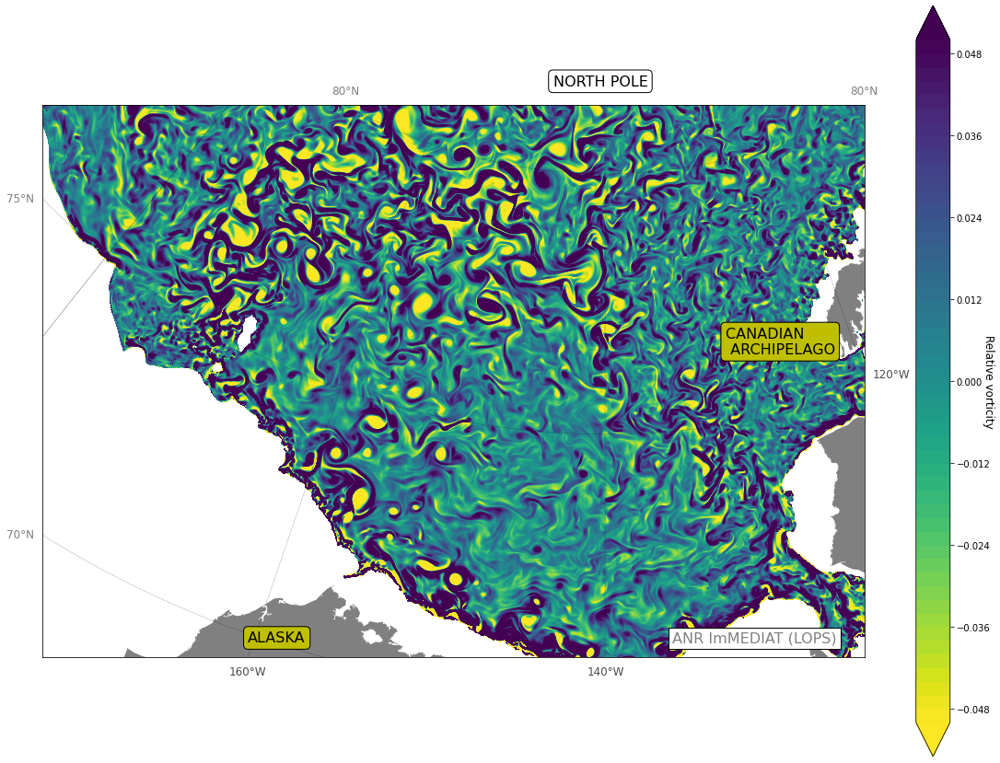

In [22]:
plt.clf()
vmin=-0.05 ; vmax=0.05 ; vint=0.002
contours=np.arange(vmin,vmax+vint,vint)
limits=[vmin,vmax]

fig=plt.figure(figsize=(20,15))
# OK but tiny fig, ax=plt.subplots()
#fig, ax=plt.figure(figsize=(20,15))
#fig, ax=plt.subplots(111)
plt.subplot(111)
Arc_plot(np.array(ds_alpha_xiz181['nav_lon']),np.array(ds_alpha_xiz181['nav_lat']), \
         ds_alpha_xiz181['socurloverf'][0,:,:], contours, limits, zmap='viridis_r', \
         proj='cassis_BGZoom',fld='Relative vorticity')

GeoBox(fig,area='zoom')
#fig, ax=plt.subplots()
#ax.add_artist(ab)

if False : plt.savefig('./FIGURES/SEDNA-ALPHA_y2003m06d23_Xif_z181m_'+ext+'Zoom.png',dpi=250)
if False : plt.savefig('./FIGURES/SEDNA-ALPHA_y2003m06d23_Xif_z181m_'+ext+'HRZoomViridis.png',dpi=700)